## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [133]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

def get_camera_calibration_points():
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob('../camera_cal/calibration*.jpg')

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            #img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
            #cv2.imshow('img',img)
            #cv2.waitKey(500)

    #cv2.destroyAllWindows()
    return (objpoints, imgpoints)





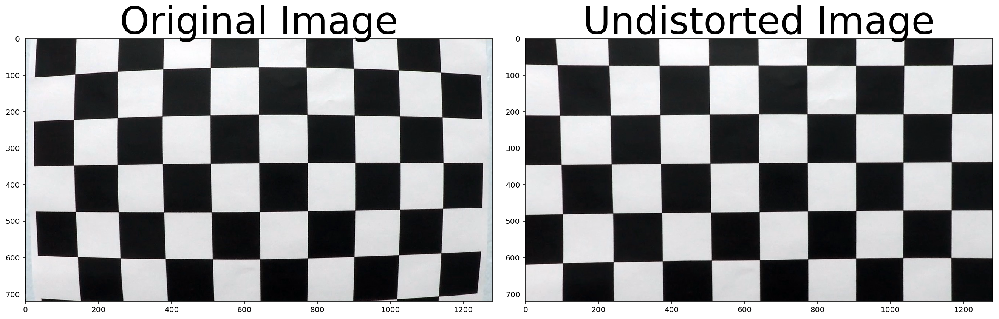

In [134]:
##Undistorting image
img= cv2.imread('../camera_cal/calibration1.jpg')

def undistort(img, objpoints, imgpoints):
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

(objpoints, imgpoints) = get_camera_calibration_points()
undistorted=undistort(img, objpoints, imgpoints)   
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

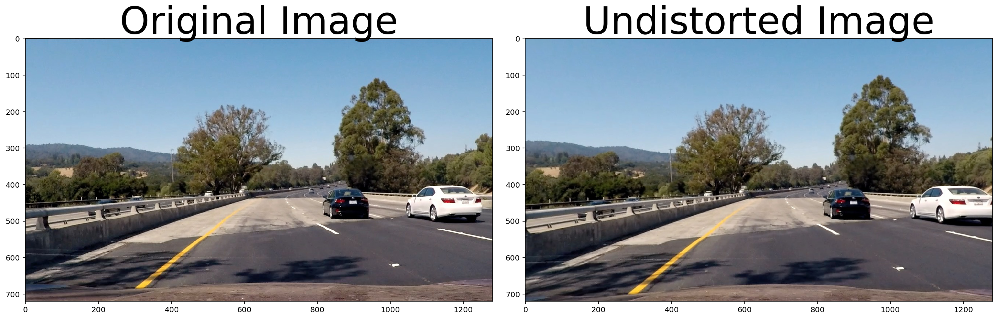

In [135]:
image_name='../test_images/test4.jpg'
img= cv2.imread(image_name)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
undistorted=undistort(img, objpoints, imgpoints)   
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Color & gradient filters

In [675]:
#image_name='../test_images/test4.jpg'
image_name='../test_images/challenge_3.jpg'
#image_name='../test_images/challenge_2.jpg'
#image_name='../test_images/challenge_1.jpg'
image = cv2.imread(image_name) #5
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
## Gradient treshold
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

%matplotlib inline
def hls_select(img, s_thresh=(0, 255), l_thresh=(0, 255), use_l = False):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    s_channel = s_channel*(255/np.max(s_channel))
    binary_output = np.zeros_like(s_channel)
    if use_l :
        l_channel = hls[:,:,1]
        l_channel = l_channel*(255/np.max(l_channel))
        binary_output[((s_channel > s_thresh[0]) & (s_channel <= s_thresh[1]) | ((l_channel > l_thresh[0]) & (l_channel <= l_thresh[1])))] = 1
    else :
        binary_output[((s_channel > s_thresh[0]) & (s_channel <= s_thresh[1]))] = 1
    return binary_output


def hsv_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]
    binary_output = np.zeros_like(v_channel)
    binary_output[(v_channel > thresh[0]) & (v_channel <= thresh[1])] = 1
    return binary_output

def grey_select(img, thresh=(0, 255)):
    grey = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    binary_output = np.zeros_like(grey)
    binary_output[(grey > thresh[0]) & (grey <= thresh[1])] = 1
    return binary_output

def lab_select(img, thresh=(190,255)):
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    b_channel = lab[:,:,2]
    # don't normalize if there are no yellows in the image
    if np.max(b_channel) > 175:
        b_channel = b_channel*(255/np.max(b_channel))
    binary_output = np.zeros_like(b_channel)
    binary_output[((b_channel > thresh[0]) & (b_channel <= thresh[1]))] = 1
    return binary_output 

def find_yellow(img):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)    
    h_channel = hsv[:,:,0]
    s_channel = hsv[:,:,1]
    v_channel = hsv[:,:,2]
    binary_output = np.zeros_like(v_channel)
    binary_output[(h_channel > 8) & (h_channel <= 100) &
                  (s_channel > 100) & (s_channel <= 255) &
                  (v_channel > 100) & (v_channel <= 255)]= 1
    return binary_output


def color_and_gradient_filter(img, ksize = 15):
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(10, 240))
    mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))
    hls_binary = hls_select(img, s_thresh=(220, 255), l_thresh=(220, 255), use_l =True) #150
    hsv_binary = hsv_select(img, thresh=(50, 255))
    grey_binary = grey_select(img, thresh=(200, 255))
    yellow_binary = find_yellow(img)
    lab_binary = lab_select(img)
    combined = np.zeros_like(grey_binary)
    #combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1) & ((hls_binary == 1) | (grey_binary == 1) | (hsv_binary == 1)))] = 1
    #combined[((gradx == 1) & (grady == 1)) | (((hls_binary == 1)  & (hsv_binary == 1) )) ] = 1
    #combined[((gradx == 1) & (grady == 1)  ) | (((hls_binary == 1) & (mag_binary == 1) )) | (yellow_binary == 1) ] = 1
    #combined[((gradx == 1) & (grady == 1)  ) | ((hls_binary == 1) | (yellow_binary == 1)) ] = 1
    
    combined[((gradx == 1) & (grady == 1)  ) | ((hls_binary == 1) | (lab_binary == 1)) ] = 1
    return combined 

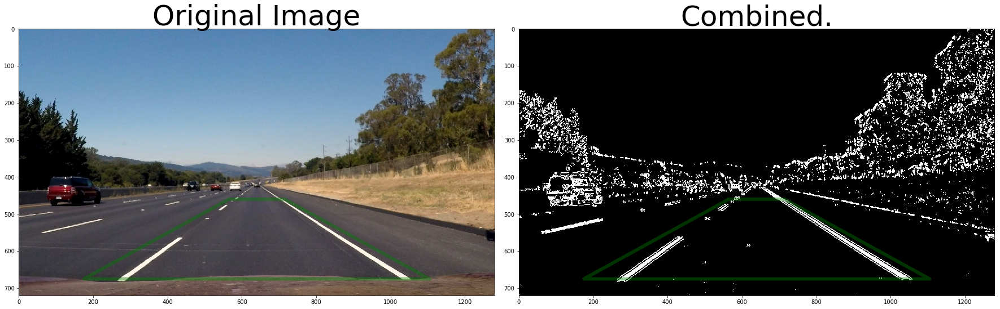

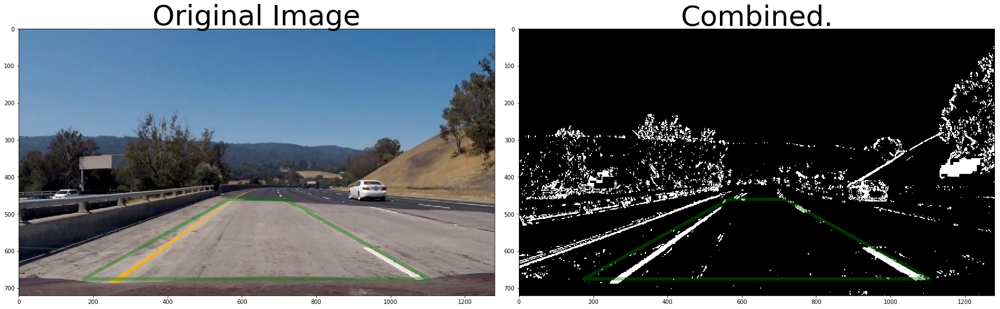

In [676]:
plot_compare(test_str2,color_and_gradient_filter(test_str2),True)   
plot_compare(challenge2_image,color_and_gradient_filter(challenge2_image),True)   

[[ 440.    0.]
 [ 840.    0.]
 [ 440.  720.]
 [ 840.  720.]]
[[  565.   460.]
 [  715.   460.]
 [  175.   675.]
 [ 1105.   675.]]


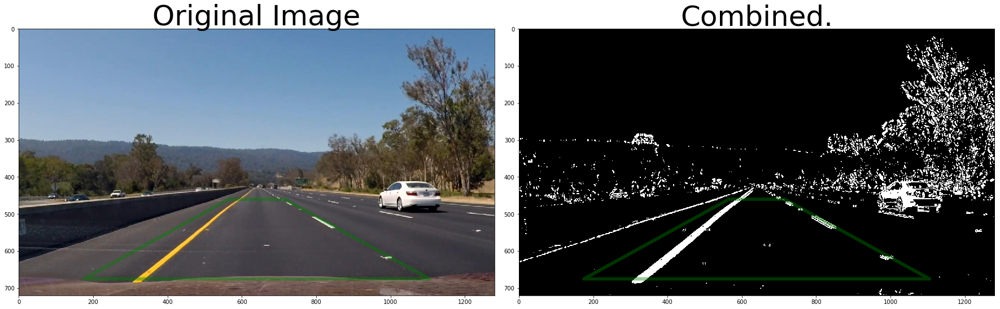

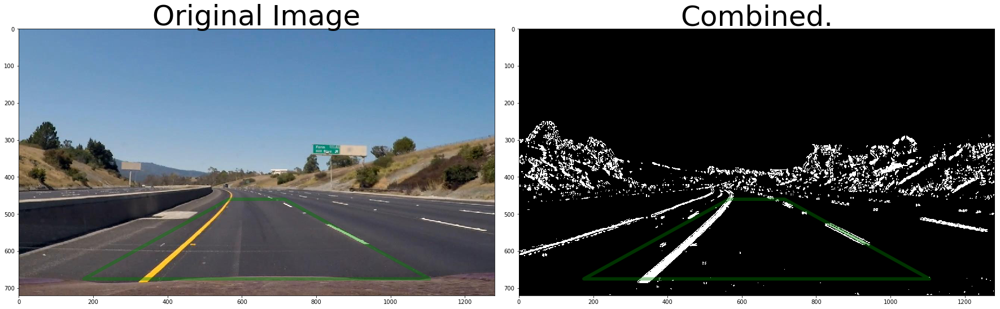

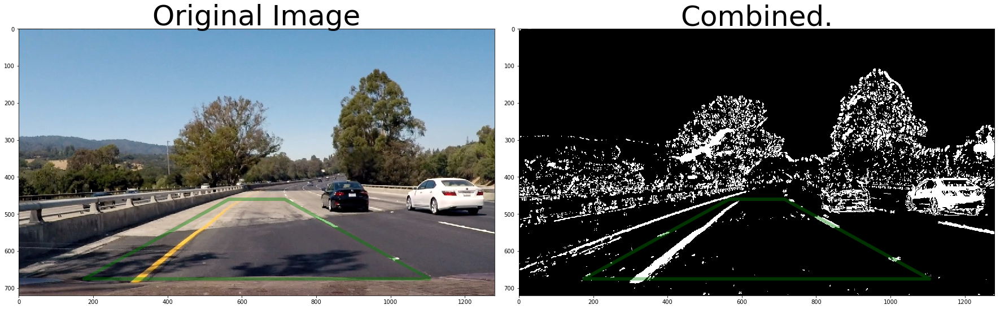

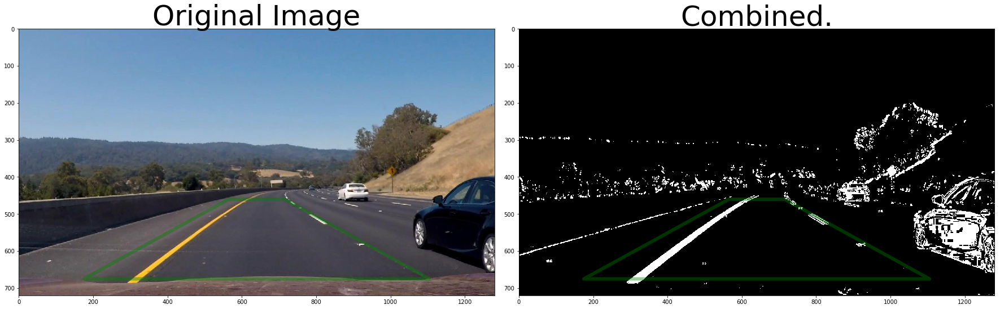

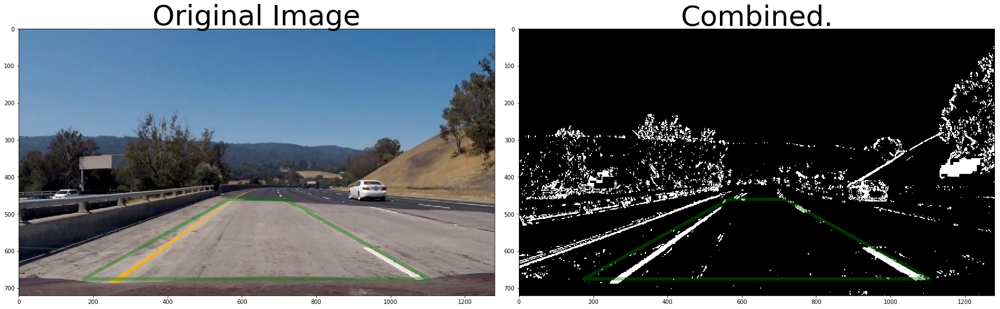

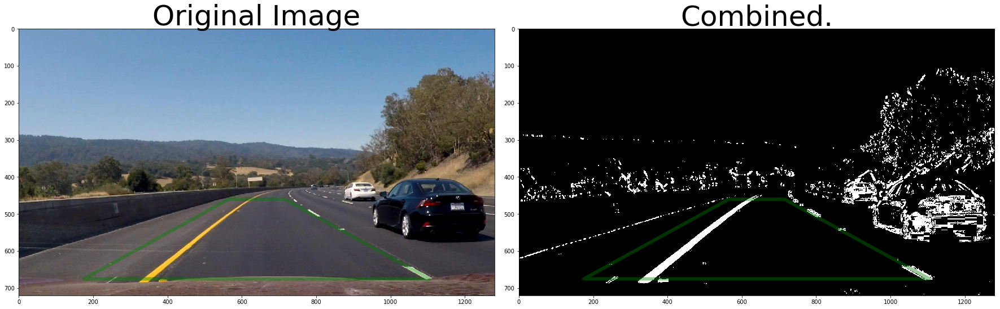

In [727]:

width=1280
height = 720
upper_trapezoid_width = 75 
lower_trapezoid_width = 465 
trapezoid_height      = 215
trapezoid_dist_bottom =  45


t_top_left     = (width/2 - upper_trapezoid_width, height - trapezoid_dist_bottom - trapezoid_height)
t_top_right    = (width/2 + upper_trapezoid_width, height - trapezoid_dist_bottom - trapezoid_height)
t_bottom_left  = (width/2 - lower_trapezoid_width, height - trapezoid_dist_bottom)
t_bottom_right = (width/2 + lower_trapezoid_width, height - trapezoid_dist_bottom)
 
square_size = 400
   
s_top_left     = (width/2 - square_size/2, 0)
s_top_right    = (width/2 + square_size/2, 0)
s_bottom_left  = (width/2 - square_size/2, height)
s_bottom_right = (width/2 + square_size/2, height)
 
src = np.float32([t_top_left,t_top_right,t_bottom_left,t_bottom_right])
dst = np.float32([s_top_left, s_top_right,s_bottom_left,s_bottom_right])

print(dst)
print(src)

test4_image = cv2.imread('../test_images/test4.jpg') #5
test4_image = cv2.cvtColor(test4_image, cv2.COLOR_BGR2RGB)
test4_image_combined = color_and_gradient_filter(test4_image)

challenge1_image = cv2.imread('../test_images/challenge_1.jpg') #5
challenge1_image = cv2.cvtColor(challenge1_image, cv2.COLOR_BGR2RGB)
challenge1_image_combined = color_and_gradient_filter(challenge1_image)

challenge2_image = cv2.imread('../test_images/challenge_2.jpg') #5
challenge2_image = cv2.cvtColor(challenge2_image, cv2.COLOR_BGR2RGB)
challenge2_image_combined = color_and_gradient_filter(challenge2_image)

challenge3_image = cv2.imread('../test_images/challenge_3.jpg') #5
challenge3_image = cv2.cvtColor(challenge3_image, cv2.COLOR_BGR2RGB)
challenge3_image_combined = color_and_gradient_filter(challenge3_image)

test_str2 = cv2.imread('../test_images/straight_lines2.jpg')
test_str2 = cv2.cvtColor(test_str2, cv2.COLOR_BGR2RGB)
test_str2_combined = color_and_gradient_filter(test_str2)

challenge4_image = cv2.imread('../test_images/challenge_4.jpg')
challenge4_image = cv2.cvtColor(challenge4_image, cv2.COLOR_BGR2RGB)
challenge4_image_combined = color_and_gradient_filter(challenge4_image)


challenge5_image = cv2.imread('../test_images/challenge_5.jpg')
challenge5_image = cv2.cvtColor(challenge5_image, cv2.COLOR_BGR2RGB)
challenge5_image_combined = color_and_gradient_filter(challenge5_image)




def plot_compare(image0, image1, trapeziod = False):
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout() 
    ax1.imshow(image0)
    x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
    y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
    if trapeziod :
        ax1.plot(x, y, color='green', alpha=0.4, linewidth=6, solid_capstyle='round', zorder=2)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(image1, cmap='gray')
    if trapeziod :
        ax2.plot(x, y, color='green', alpha=0.4, linewidth=6, solid_capstyle='round', zorder=2)
    ax2.set_title('Combined.', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


#plot_compare(test_str2,test_str2_combined,True)   

plot_compare(challenge4_image,challenge4_image_combined,True)  
plot_compare(challenge5_image,challenge5_image_combined,True)  

plot_compare(test4_image,test4_image_combined, True )    
plot_compare(challenge1_image,challenge1_image_combined, True )
plot_compare(challenge2_image,challenge2_image_combined, True )   
plot_compare(challenge3_image,challenge3_image_combined,True)   


 

## Perspective transform

In [ ]:


def warp(img, src, dst):

    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)  # keep same size as input image

    return warped

def unwarp(img, src, dst):
    img_size = (img.shape[1], img.shape[0])
    Minv = cv2.getPerspectiveTransform(dst, src)
    unwarped = cv2.warpPerspective(img, Minv, img_size, flags=cv2.INTER_LINEAR)
    return unwarped


#plot_compare(test4_image_combined,warp(test4_image_combined, src, dst), True )    
#plot_compare(challenge1_image_combined,warp(challenge1_image_combined, src, dst), True  )
#plot_compare(challenge2_image_combined,warp(challenge2_image_combined, src, dst), True  )   
#plot_compare(challenge3_image_combined,warp(challenge3_image_combined, src, dst), True ) 


#plot_compare(challenge2_image,warp(challenge2_image,src, dst), True )  
#plot_compare(challenge4_image,warp(challenge4_image,src, dst), True ) 
#plot_compare(challenge5_image,warp(challenge5_image,src, dst), True ) 

## Find sliding windows

In [720]:
class WindowFinder:
    
    def __init__(self, window_width=50, window_height=80, margin=100, meters_pp_y = 1, meters_pp_x= 1, smooth_factor = 15) :
        self.centers = []
        self.window_width = window_width
        self.window_height = window_height
        self.margin = margin
        self.meters_pp_y=meters_pp_y
        self.meters_pp_x=meters_pp_x
        self.smooth_factor=smooth_factor

    def find_window_centroids(self, image):
        window_width = self.window_width
        window_height= self.window_height
        margin= self.margin
        window_centroids = [] # Store the (left,right) window centroid positions per level
        window = np.ones(window_width) # Create our window template that we will use for convolutions


        #histogram = np.sum(image[image.shape[0]//2:,:], axis=0)
        histogram = np.sum(image[image.shape[0]*7//8:,:], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        quarter_point = np.int(midpoint//2)
        quarter_point_3_of_4 = np.int(quarter_point)*3//4 ##number that normally removed all other objects
        # Previously the left/right base was the max of the left/right half of the histogram
        # this changes it so that only a quarter of the histogram (directly to the left/right) is considered
        l_center = np.argmax(histogram[quarter_point:midpoint]) + quarter_point
        r_center = np.argmax(histogram[midpoint:(midpoint+quarter_point_3_of_4)]) + midpoint
        
        
        window_centroids.append((l_center,r_center))

        # Go through each layer looking for max pixel locations
        for level in range(1,(int)(image.shape[0]/window_height)):
            # convolve the window into the vertical slice of the image
            image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
            conv_signal = np.convolve(window, image_layer)
            # Find the best left centroid by using past left center as a reference
            # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
            offset = window_width/2
            l_min_index = int(max(l_center+offset-margin,0))
            l_max_index = int(min(l_center+offset+margin,image.shape[1]))
            pixels_l = conv_signal[l_min_index:l_max_index]
            #print(pixels_l)
            #if (pixels_l.any() > 5) :
            l_center_new = np.argmax(pixels_l)+l_min_index-offset
            #l_center = np.argmax(pixels_l)+l_min_index-offset
            if abs(l_center-l_center_new) < 20 :
                l_center = l_center_new
            # Find the best right centroid by using past right center as a reference
            r_min_index = int(max(r_center+offset-margin,0))
            r_max_index = int(min(r_center+offset+margin,image.shape[1]))
            pixels_r = conv_signal[r_min_index:r_max_index]
            r_center_new = np.argmax(pixels_r)+r_min_index-offset
            if abs(r_center-r_center_new) < 20 :
                r_center = r_center_new
            # Add what we found for that layer
            window_centroids.append((l_center,r_center))

        self.centers.append(window_centroids)
        return np.average(self.centers[-self.smooth_factor:], axis=0)

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def get_window_centers(warped_image, meters_pp_y, meters_pp_x, window_width,window_height, margin ):
    curve_centers=WindowFinder(window_width=window_width, window_height=window_height, margin=margin,meters_pp_y=meters_pp_y,meters_pp_x=meters_pp_x )
    window_centroids= curve_centers.find_window_centroids(image=warped_image)

    #points to fit to polinom
    leftx= []
    rightx= []
    l_points = np.zeros_like(warped_image)
    r_points = np.zeros_like(warped_image)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas

        #adding center value for drawing
        leftx.append(window_centroids[level][0])
        rightx.append(window_centroids[level][1])
        l_mask = window_mask(window_width,window_height,warped_image,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped_image,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255
    return (leftx, rightx,r_points, l_points, curve_centers)

def draw_results(r_points, l_points, warped) :
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    #print(type(template))
    warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
    #print(type(warpage))
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)
    return result

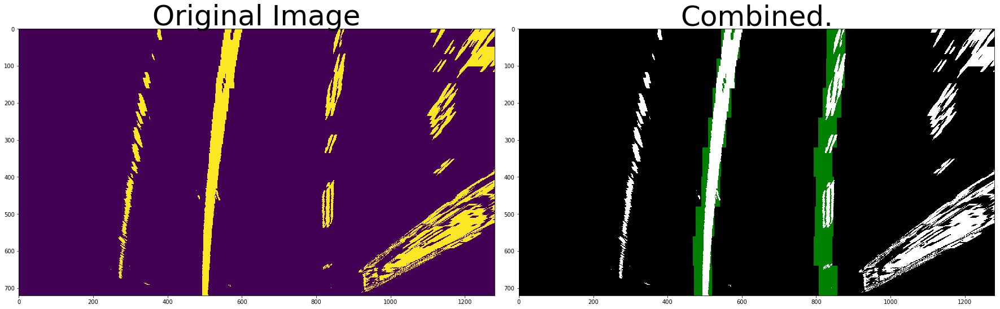

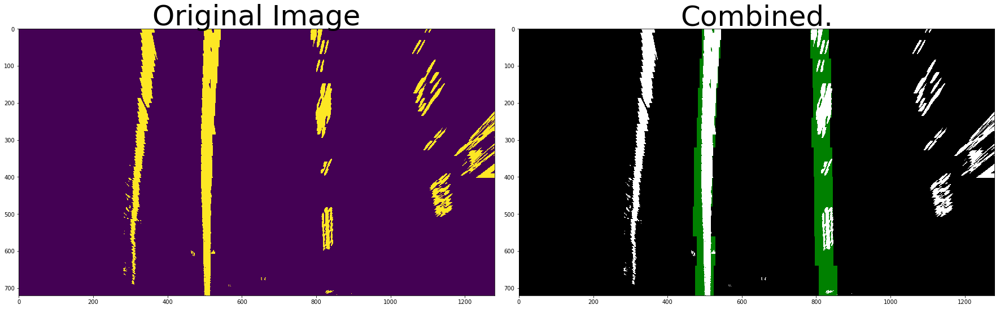

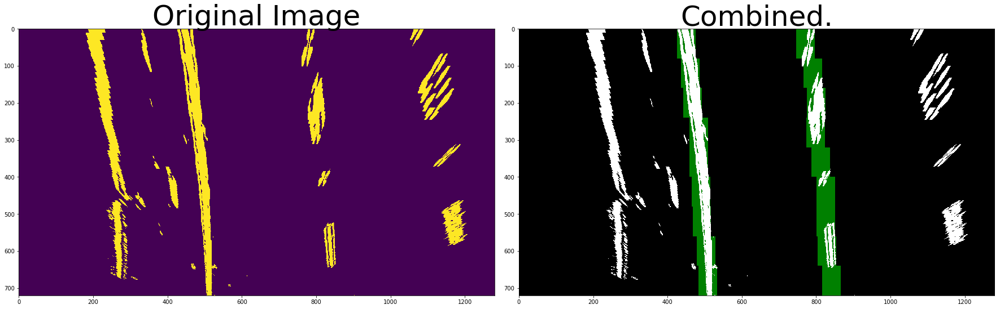

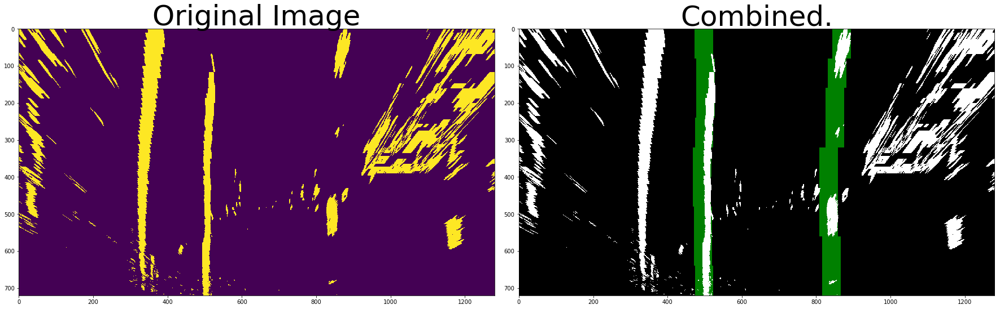

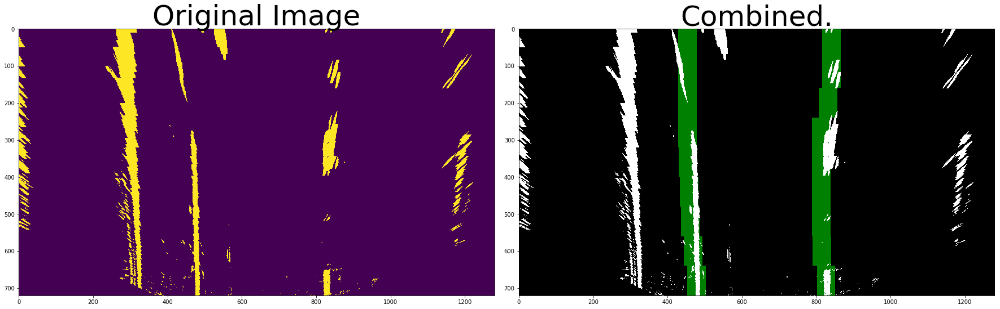

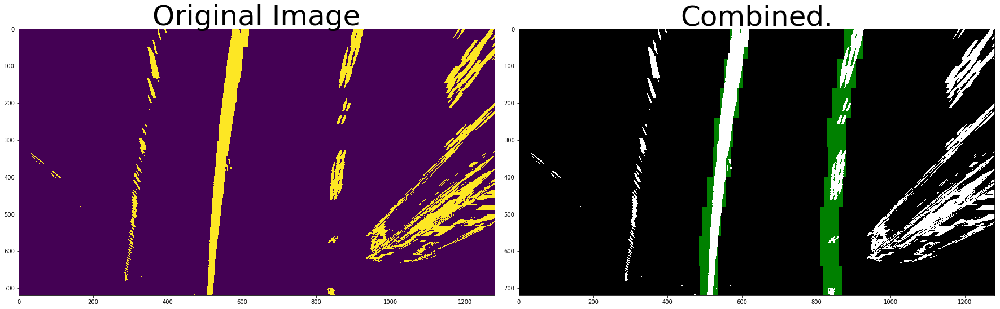

In [664]:

images = [challenge1_image, challenge4_image, challenge5_image, test4_image,challenge2_image,challenge3_image]
for i in images :
    i_c = color_and_gradient_filter(i)
    i_wraped = warp(i_c,src, dst)
    #i_wraped = warp(i,src, dst)
    #i_c = color_and_gradient_filter(i_wraped)
    
    #print(i_wraped.shape)
    
    (leftx, rightx,r_points,l_points, curve_centers) = get_window_centers(i_wraped)
    result = draw_results(r_points,l_points, i_wraped)
    plot_compare(i_wraped,result )

In [665]:
image_name='../test_images/challenge_3.jpg'
#image_name='../test_images/challenge_2.jpg'
#image_name='../test_images/challenge_1.jpg'
image = cv2.imread(image_name) #5
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [697]:
class Line():
    def __init__(self, n = 2):
        # was the line detected in the last iteration?
        self.detected = False 
        self.n = n
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
        
    def get_polyfit(self, result_y) :
        #print(result_y)
        #print(type(result_y))
        if (len(self.recent_xfitted)> (self.n + 1)) :
            self.recent_xfitted.pop(0)
        x_avg = np.median(self.recent_xfitted, axis=0)
        if (len(self.recent_xfitted) > 0 | self.detected) :
            poly_fit = np.polyfit(result_y, x_avg, 2)
        else :
            poly_fit = np.polyfit(result_y, self.allx, 2)
        return poly_fit


## Decorating the frame

In [712]:

def get_final_image(image_input, warped,leftx, rightx, curve_centers, window_height, window_width,src_points,dest_points, right_line, left_line ):
    
    max_curvature = 1500.
    # fit centers of boxes to polinomial of second degree
    lane_y =range(0, warped.shape[0])
    # box centers
    result_y = np.arange(warped.shape[0]-(window_height/2), 0, -window_height)

    
    ##First calculate the fit based only on this frame 
    left_fit = np.polyfit(result_y, leftx, 2)
    #right line
    right_fit = np.polyfit(result_y, rightx, 2)   
    
    left_fitx = np.array(left_fit[0]*lane_y*lane_y + left_fit[1]*lane_y + left_fit[2], np.int32)    
    right_fitx = np.array(right_fit[0]*lane_y*lane_y + right_fit[1]*lane_y + right_fit[2], np.int32)

    #Calculating difference from center, assuming tthe middle of the picture should be the center
    #meters_to_center=  ( (left_fitx[-1] + right_fitx[-1]) /2 - warped.shape[1]/2)*curve_centers.meters_pp_x
    meters_to_center =  ( (left_fitx[-1] + right_fitx[-1]) /2 - warped.shape[1]/2)*curve_centers.meters_pp_x
    
    #calculate curvature radius by formular based on polynomial coefficients, take left turn
    left_fit_x_r= np.array(left_fitx, np.float32)*curve_centers.meters_pp_x
    left_fit_y_r= np.array(lane_y, np.float32)*curve_centers.meters_pp_y
    polynomila_fit_real = np.polyfit(left_fit_y_r, left_fit_x_r, 2)
    left_curverad = ((1 + (2*polynomila_fit_real[0]*lane_y[-1]*curve_centers.meters_pp_y + polynomila_fit_real[1])**2)**1.5) / np.absolute(2*polynomila_fit_real[0])

    ## check if the result is plausible, otherwise take prevoius 
    if ((meters_to_center < 0.7) & (meters_to_center > 0.1) ): #& (left_curverad < 1100.)):
        ## if detected
        left_line.detected = True
        right_line.recent_xfitted.append(rightx)
        left_line.recent_xfitted.append(leftx)
        if ((left_curverad < max_curvature*3.) & (left_line.radius_of_curvature is not None)) :         
            left_curverad = (left_curverad + left_line.radius_of_curvature) / 2  ##take average of the previous
            left_line.radius_of_curvature = left_curverad
        #else if (!left_line.radius_of_curvature): 
        #    left_curverad = left_line.radius_of_curvature    
    else : 
        if (left_line.radius_of_curvature) : ###to test without prevoius value
            left_curverad = left_line.radius_of_curvature

    left_fit = left_line.get_polyfit(result_y) 
    right_fit= right_line.get_polyfit(result_y)
    left_fitx = np.array(left_fit[0]*lane_y*lane_y + left_fit[1]*lane_y + left_fit[2], np.int32)    
    right_fitx = np.array(right_fit[0]*lane_y*lane_y + right_fit[1]*lane_y + right_fit[2], np.int32)
    left_fit_x_r= np.array(left_fitx, np.float32)*curve_centers.meters_pp_x
    left_fit_y_r= np.array(lane_y, np.float32)*curve_centers.meters_pp_y

    points_left = np.array([np.transpose(np.vstack([left_fitx, lane_y]))])
    points_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, lane_y])))])     
        
    #making line thicker so it gets drawn better
    left_line = np.array(list(zip(np.concatenate((left_fitx-window_width/2, left_fitx[::-1]+window_width/2), axis=0), np.concatenate((lane_y, lane_y[::-1]), axis=0))), np.int32)
    right_line = np.array(list(zip(np.concatenate((right_fitx-window_width/2, right_fitx[::-1]+window_width/2), axis=0), np.concatenate((lane_y, lane_y[::-1]), axis=0))), np.int32)

    
    ## drawing lanes
    lanes = np.zeros_like(image_input)
    inbetween_lanes = np.zeros_like(image_input)
    cv2.fillPoly(lanes, [left_line], color=[200,0,0])
    cv2.fillPoly(lanes, [right_line], color=[0,0,200])
        

    points = np.hstack((points_left, points_right))

    cv2.fillPoly(inbetween_lanes, [points], color=(0, 255, 0))
    cv2.fillPoly(inbetween_lanes, [left_line], color=(0, 255, 0))
    cv2.fillPoly(inbetween_lanes, [right_line], color=(0, 255, 0))
    lanes_wraped=unwarp(lanes,src_points, dest_points )
    inbetween_lanes_warped = unwarp(inbetween_lanes,src_points, dest_points )

    image_with_lines = cv2.addWeighted(image_input, 1.0, inbetween_lanes_warped, 0.3, 0.0)
    image_with_lines_road = cv2.addWeighted(image_with_lines, 1.0, lanes_wraped, 1.0, 0.0)
    font = cv2.FONT_HERSHEY_DUPLEX
    font_color = (255, 255, 255)
    font_scale = 1
    font_thickness = 2
    cv2.putText(image_with_lines_road, 'Left radius of curvature: %d m' % (round(left_curverad)), (50,50), font, font_scale, font_color, font_thickness)
    cv2.putText(image_with_lines_road, 'Meters_to_center: %1.2f m' % (meters_to_center), (50,80), font, font_scale, font_color, font_thickness)
    return image_with_lines_road

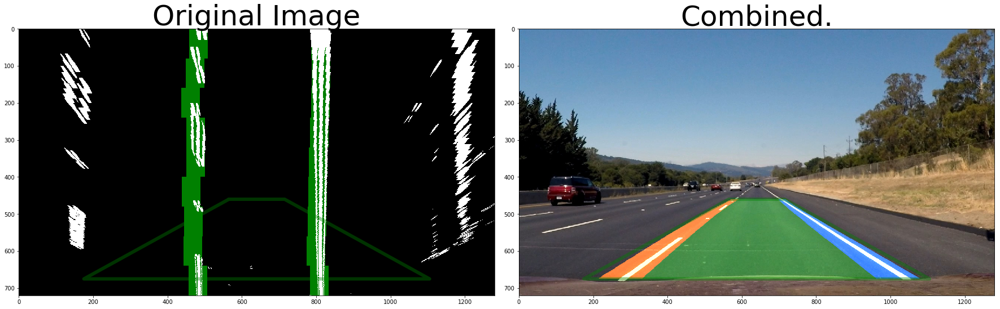

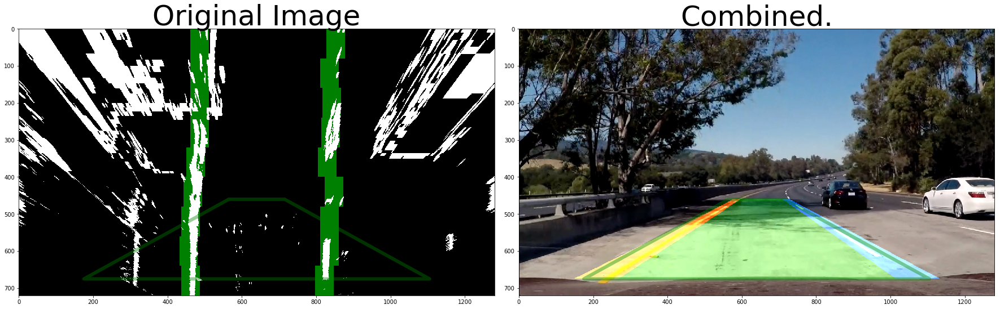

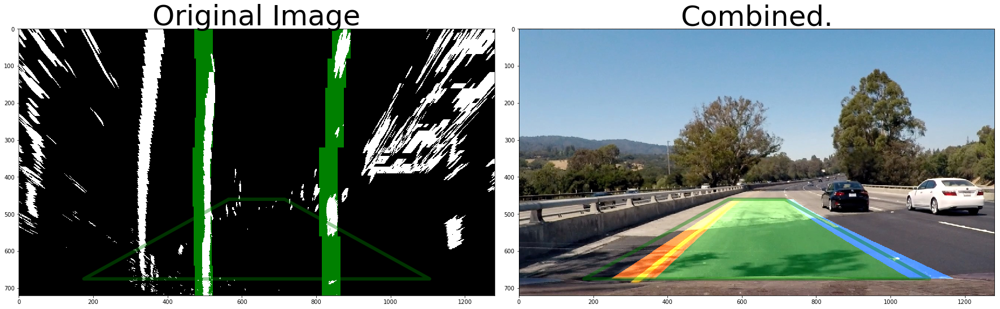

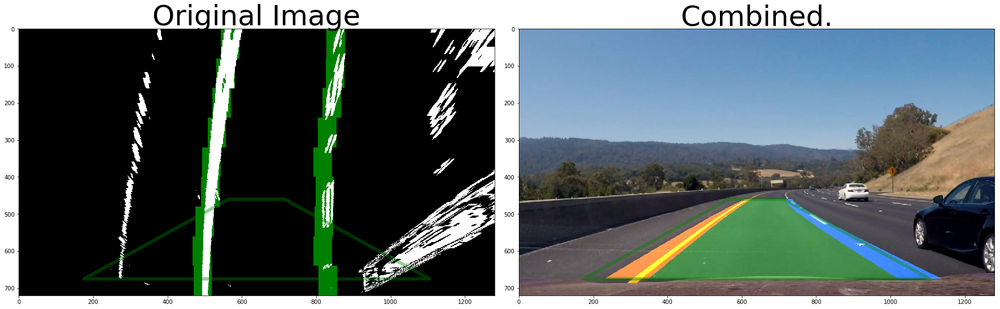

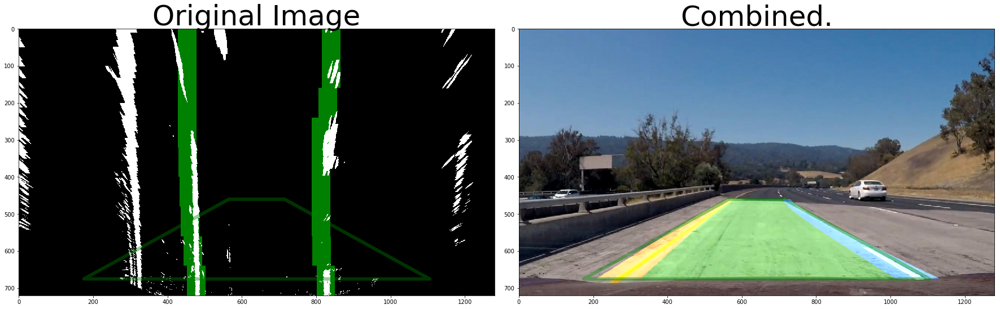

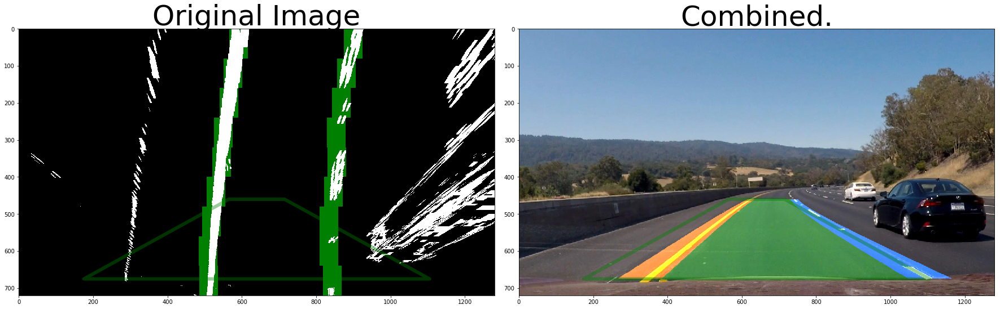

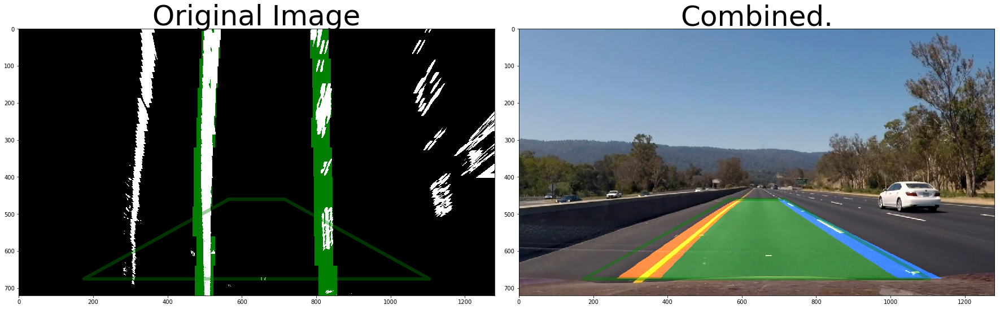

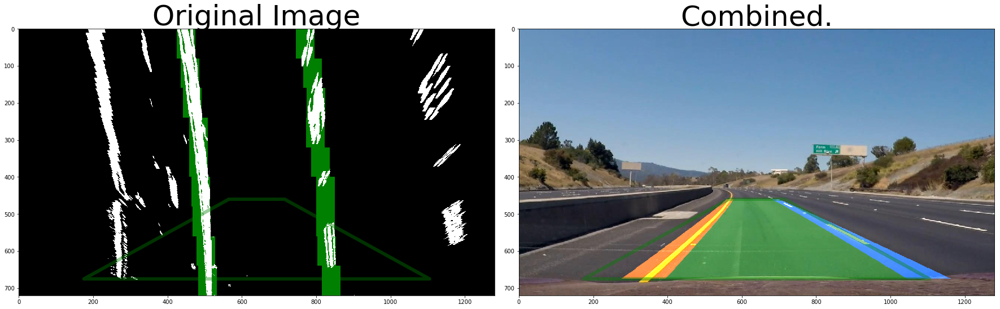

In [669]:

test_image5 = cv2.imread('../test_images/test5.jpg') #5
test_image5 = cv2.cvtColor(test_image5, cv2.COLOR_BGR2RGB)
test_str2 = cv2.imread('../test_images/straight_lines2.jpg')
test_str2 = cv2.cvtColor(test_str2, cv2.COLOR_BGR2RGB)



images = [test_str2, test_image5, test4_image, challenge1_image,challenge2_image,challenge3_image, challenge4_image,challenge5_image]
for i in images :
    #i = gaussian_blur(i, 5)
    i_combined = color_and_gradient_filter(i)
    i_wraped = warp(i_combined,src, dst)
    #print(i_wraped.shape)
    window_width=50
    window_height=80
    margin=50
    meters_pp_y = 3/107#10/720 
    meters_pp_x = 3.7/380#657#4/380
    (leftx, rightx,r_points,l_points, curve_centers) = get_window_centers(i_wraped, meters_pp_y, meters_pp_x, window_width,window_height, margin )
    result = draw_results(r_points,l_points, i_wraped)
    right_line = Line()
    left_line = Line()
    right_line.allx = rightx
    left_line.allx = leftx


    result_1 = get_warped_lanes(i, i_wraped, leftx, rightx,window_height, window_width, src, dst)
    
    #result_1 = get_final_image(i, i_wraped,leftx, rightx, curve_centers, window_height, window_width,src,dst, right_line, left_line )
    plot_compare(result,result_1, True)

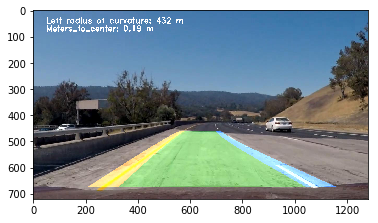

In [723]:


(cal_objpoints, cal_imgpoints) = get_camera_calibration_points()

##Empty line object at the begining
right_line = Line()
left_line = Line()

def pipeline(init_image, right_line, left_line, src_points, dest_points):

    window_width=50#30
    window_height=80
    margin=50#25
    meters_pp_y = 0.028#3/107#10/720 
    meters_pp_x = 3.7/380#657#4/380
    #first undistort 
    undistorted=undistort(init_image, cal_objpoints, cal_imgpoints)  
    masked_image= color_and_gradient_filter(undistorted, ksize = 15)
    warped = warp(masked_image,src_points, dest_points)
    (leftx, rightx,r_points, l_points, curve_centers) = get_window_centers(warped,meters_pp_y, meters_pp_x, window_width,window_height, margin)
    
    #update lines
    #right_line.recent_xfitted.append(rightx)
    right_line.allx = rightx
    #left_line.recent_xfitted.append(leftx)
    left_line.allx = leftx
    
    final_image = get_final_image(init_image, warped, leftx, rightx, curve_centers, window_height,window_width,
                                 src_points=src_points,dest_points=dest_points,
                                 right_line=right_line, left_line=left_line)
    return final_image

plt.imshow(pipeline(challenge2_image, right_line, left_line, src, dst))
plt.show()



['../test_images/challenge_1.jpg', '../test_images/challenge_2.jpg', '../test_images/challenge_3.jpg', '../test_images/challenge_4.jpg', '../test_images/challenge_5.jpg', '../test_images/straight_lines1.jpg', '../test_images/straight_lines2.jpg', '../test_images/test1.jpg', '../test_images/test2.jpg', '../test_images/test3.jpg', '../test_images/test4.jpg', '../test_images/test5.jpg', '../test_images/test6.jpg']
../test_images/challenge_1.jpg
../test_images/challenge_2.jpg
../test_images/challenge_3.jpg
../test_images/challenge_4.jpg
../test_images/challenge_5.jpg
../test_images/straight_lines1.jpg
../test_images/straight_lines2.jpg
../test_images/test1.jpg
../test_images/test2.jpg
../test_images/test3.jpg
../test_images/test4.jpg
../test_images/test5.jpg
../test_images/test6.jpg


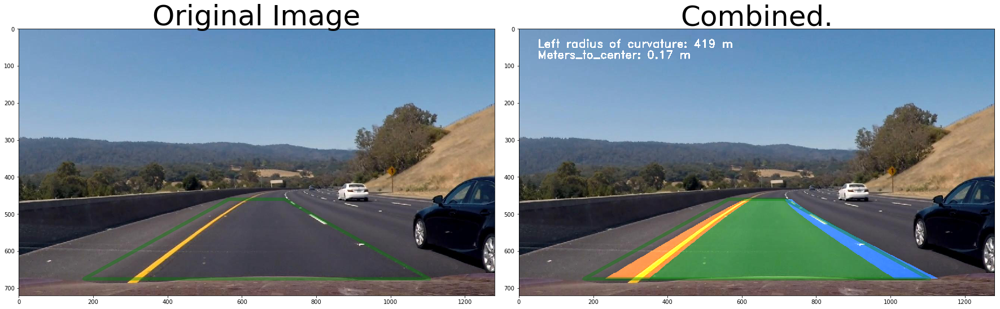

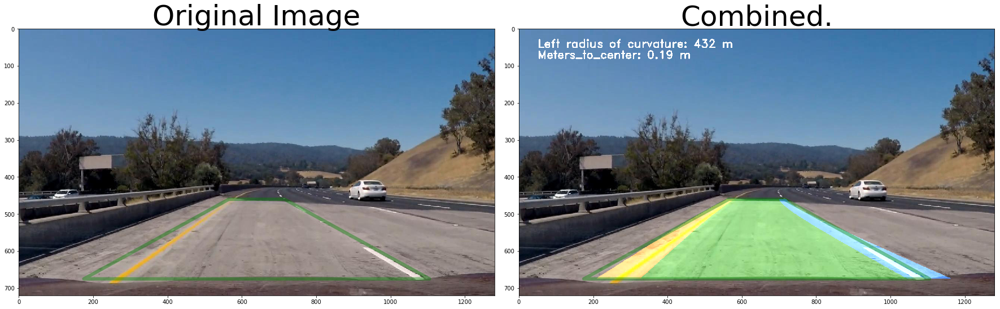

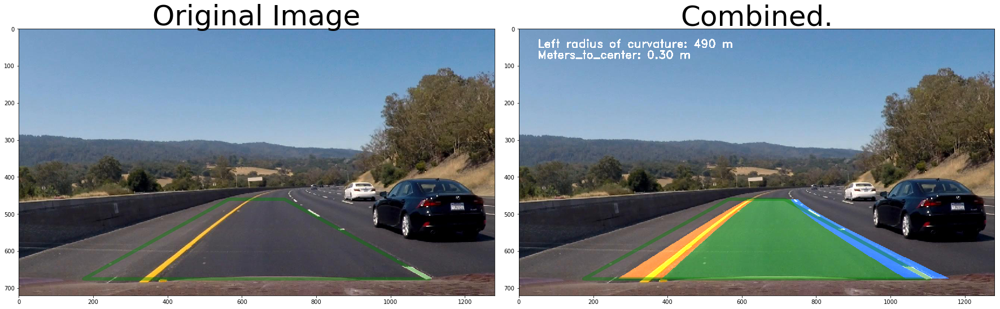

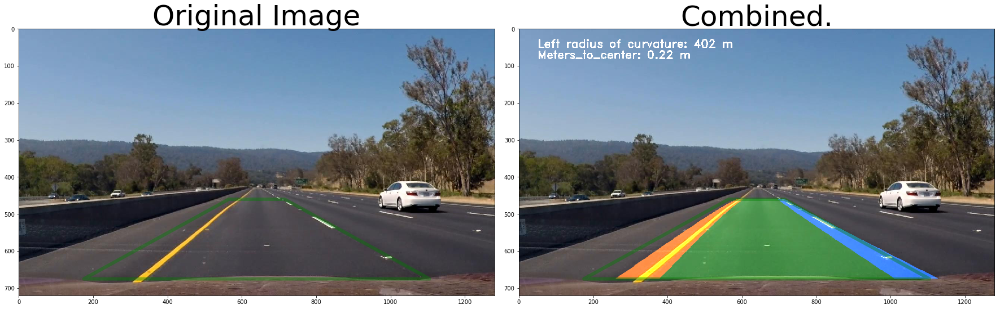

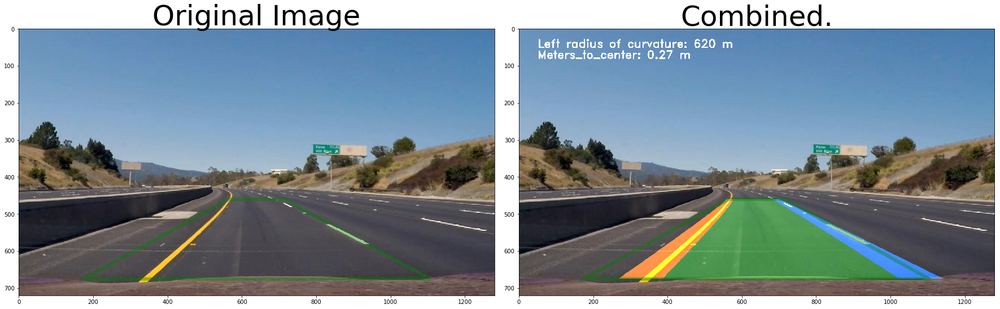

...

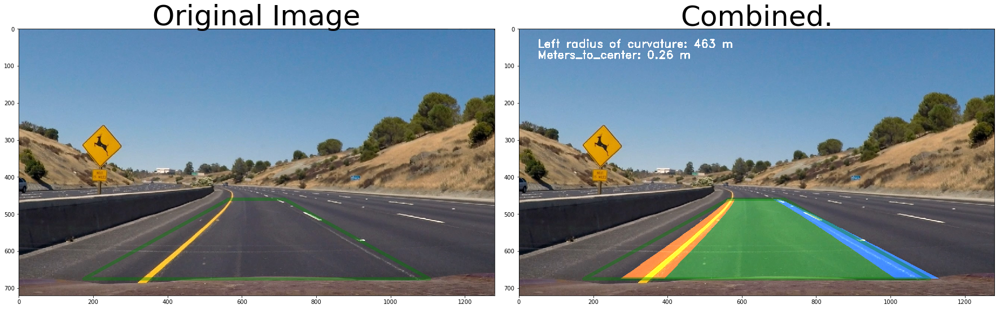

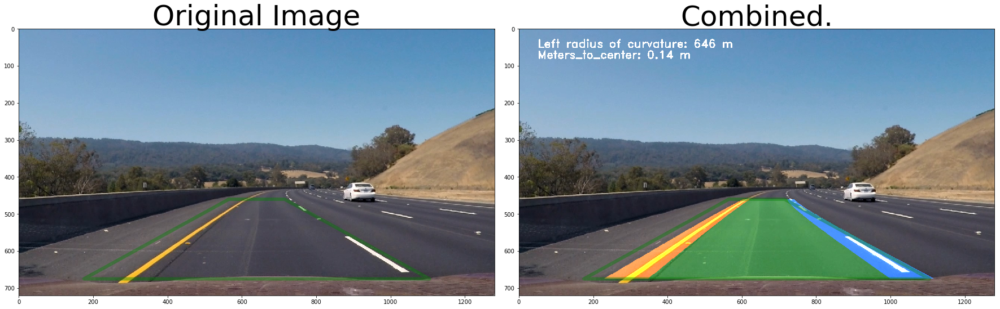

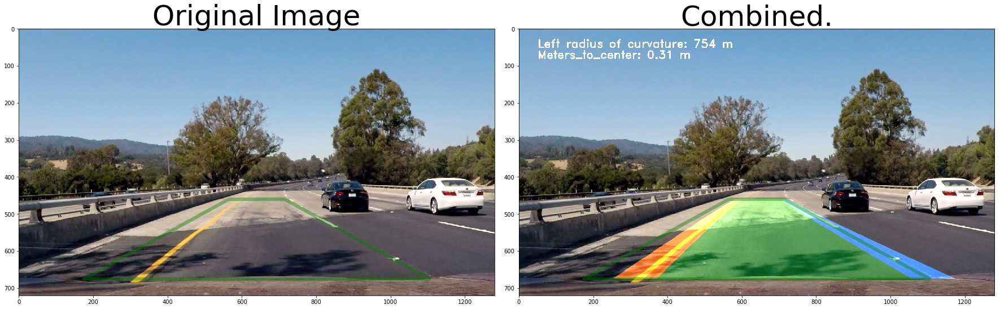

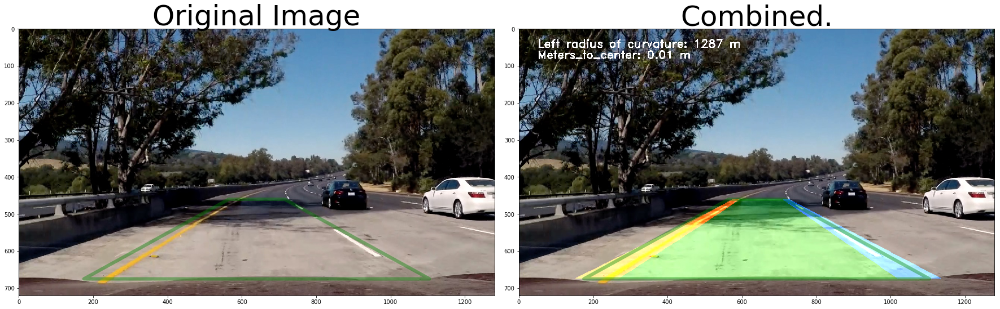

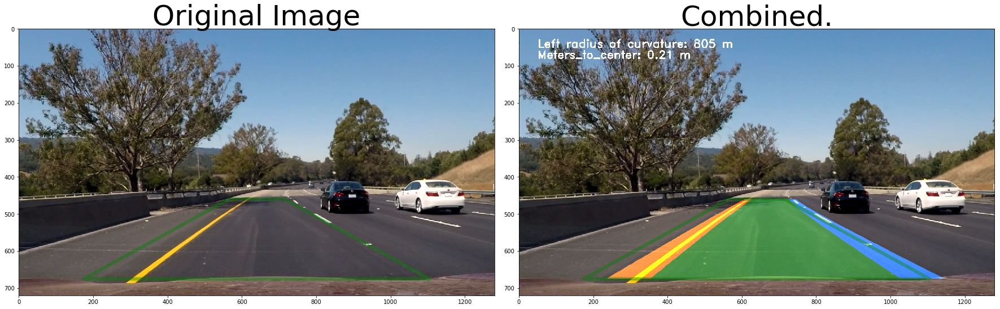

In [724]:

images = glob.glob('../test_images/*.jpg')
print(images)
for fname in images:
    img = cv2.imread(fname)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    right_line = Line()
    left_line = Line()
    decorated= pipeline(img, right_line, left_line, src, dst)
    print(fname)
    plot_compare(img,decorated, True)
    #plt.imshow(decorated)
    #plt.show()


In [725]:
from moviepy.editor import VideoFileClip
output_video = 'result_1.mp4'
input_video = '../project_video.mp4'
right_line = Line(n=2)
left_line = Line(n=2)
clip_0 = VideoFileClip(input_video)#.subclip(22, 27)
result_video = clip_0.fl_image(lambda image : pipeline(image, right_line, left_line, src, dst))
%time result_video.write_videofile(output_video, audio=False)

[MoviePy] >>>> Building video result_1.mp4
[MoviePy] Writing video result_1.mp4




  0%|          | 0/1261 [00:00<?, ?it/s]

  0%|          | 1/1261 [00:01<28:09,  1.34s/it]

  0%|          | 2/1261 [00:02<28:19,  1.35s/it]

  0%|          | 3/1261 [00:03<27:38,  1.32s/it]

  0%|          | 4/1261 [00:05<27:47,  1.33s/it]

  0%|          | 5/1261 [00:06<27:59,  1.34s/it]

  0%|          | 6/1261 [00:07<27:06,  1.30s/it]

  1%|          | 7/1261 [00:08<26:13,  1.25s/it]

  1%|          | 8/1261 [00:10<26:06,  1.25s/it]

  1%|          | 9/1261 [00:11<25:40,  1.23s/it]

  1%|          | 10/1261 [00:12<25:12,  1.21s/it]

  1%|          | 11/1261 [00:13<24:46,  1.19s/it]

  1%|          | 12/1261 [00:14<24:24,  1.17s/it]

  1%|          | 13/1261 [00:15<24:27,  1.18s/it]

  1%|          | 14/1261 [00:16<24:41,  1.19s/it]

  1%|          | 15/1261 [00:17<24:38,  1.19s/it]

  1%|▏         | 16/1261 [00:18<24:36,  1.19s/it]

  1%|▏         | 17/1261 [00:20<24:27,  1.18s/it]

  1%|▏         | 18/1261 [00:21<24:17,  1.17s/it]

  2%|▏         | 19/1261 [00:22<24:06,  1.16s/i

[MoviePy] Done.
[MoviePy] >>>> Video ready: result_1.mp4 

CPU times: user 23min 54s, sys: 2min 8s, total: 26min 3s
Wall time: 30min 46s


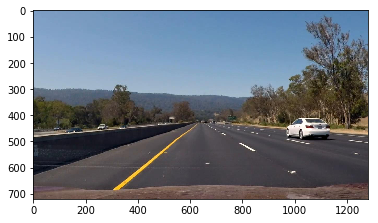

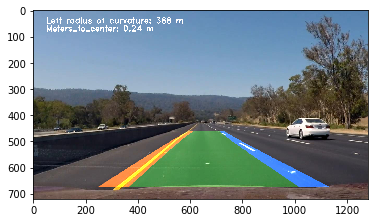

In [672]:
##saving challenging pictures
challenge_name = '../test_images/challenge_4.jpg'
clip_0.save_frame(challenge_name, t=14.69)
challenge_img = cv2.imread(challenge_name) #5
challenge_img = cv2.cvtColor(challenge_img, cv2.COLOR_BGR2RGB)
plt.imshow(challenge_img)
plt.show()
plt.imshow(pipeline(challenge_img,  right_line, left_line, src, dst))
plt.show()

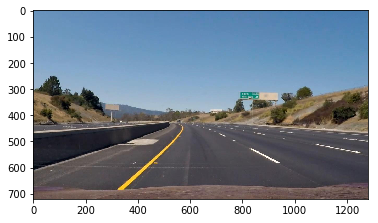

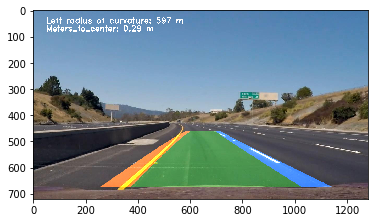

In [673]:
challenge_name = '../test_images/challenge_5.jpg'
clip_0.save_frame(challenge_name, t=0.5)
challenge_img = cv2.imread(challenge_name) #5
challenge_img = cv2.cvtColor(challenge_img, cv2.COLOR_BGR2RGB)
plt.imshow(challenge_img)
plt.show()
plt.imshow(pipeline(challenge_img,  right_line, left_line, src, dst))
plt.show()